
<h1>
MEJORANDO LA RESOLUCIÓN EN IMÁGENES SATELITALES MEDIANTE TÉCNICAS DE DEEP LEARNING
</h1>

<hr>

- Johan Sebastian Muñoz Ossa - js.munoz.ai@gmail.com


**¿Qué es la resolución en imágenes?**
La resolución de una imagen indica la cantidad de detalles que puede observarse en esta. El término es comúnmente utilizado en relación a imágenes de fotografía digital, pero también se utiliza para describir cuán nítida (como antónimo de granular) es una imagen de fotografía convencional (o fotografía química). Tener mayor resolución se traduce en obtener una imagen con más detalle o calidad visual.

**Superresolución en imágenes:**
Se conoce como superresolución al conjunto de técnicas y algoritmos diseñados para aumentar la resolución espacial de una imagen, normalmente a partir de una secuencia de imágenes de más baja resolución para lograr esto, una función matemática toma la imagen en baja resolución (con falta de detalles) y rellena esta información para así producir la imagen de mayor resolución.

**¿Por qué?**
Muchos procesos de adquisición de imágenes, los cuales son importantes para el desarrollo económico y tecnológico, suelen ser difíciles de llevar a cabo debido a las condiciones con las que se obtienen estas. Por lo tanto, entregan imágenes de calidades menores a las necesarias para ser usadas. Un claro ejemplo es el caso de estudio que se busca abordar, la adquisición de imágenes satelitales, donde las grandes distancias, la cantidad de ruido presente en la atmósfera y los difíciles procesos de transmisión de los datos, generan imágenes con calidades que pueden (y por lo general deben) ser mejoradas mediante algún método de visión artificial.

**¿Para qué?**
La superresolución juega un papel protagónico en la última década puesto que tiene diversas aplicaciones en gran variedad de industrias, para lograr obtener más información como por ejemplo:

Mejorar la calidad visual de videojuegos Mejorar la calidad de películas e imágenes antiguas Mejorar la calidad de imágenes médicas para tener un mejor diagnóstico de los pacientes (vasos sanguíneos, células, lunares de piel, etc.) Mejorar la calidad de imágenes astronómicas para llevar a cabo estudios más detallados (Por ejemplo, reto de la NASA: super - resolución aplicada a la corona solar para mejorar la calidad de las imágenes). Mejorar la calidad de las imágenes satelitales para diversos usos como por ejemplo planes de ordenamiento territorial, análisis de terreno para cultivo, minería, entre otros.

**¿Cómo?**
El objetivo de este trabajo se basa en "únicamente" mejorar la resolución de las imágenes. Cabe anotar que el procedimiento a seguir es puramente heurístico y por ahora el interés no es profundizar teóricamente en el tema. Para esto se probarán las diversas técnicas propias de la disciplina de visión por computador, en esta notebook se trabaja con una red neuronal convolucional.

<h1>
1. Importar Librerías
</h1>

<hr>

In [ ]:
# Librerías útiles
import datetime

# Cálculo numérico
import os
import math
import numpy as np

# Manipulación de imágenes
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import PIL
from IPython.display import display

# Trabajo con Aprendizaje Profundo
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory


# Acceder a los datos alojados en Google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


<h1>
2. Acceder a los datos desde Google Drive
</h1>

<hr>

### Dataset
El dataset se obtiene del reto presentado en el CVPR 2018, uno de los congresos anuales más reconocidos en visión por computador.

http://deepglobe.org/challenge.html

página del reto y donde se obtuvo el dataset:

https://competitions.codalab.org/competitions/18467#learn_the_details


El dataset seleccionado es el DeepGlobe Road Extraction, el cual consiste en un conjunto de datos para segmentar caminos, sin embargo para nuestro problema hemos eliminado las máscaras del dataset.

In [ ]:
# Directorio donde se encuentra el dataset
path_img = '/content/drive/MyDrive/Super-resolución V.A./'

# carpetas de datos en alta resolución
root_dir= os.path.join(path_img, 'images')      

# Se deben tener 7433 datos en alta resolución
print("Total de imágenes en alta resolución: ", len(os.listdir(root_dir)))

Total de imágenes en alta resolución:  7433


<h1>
3. Preparación de los datos
</h1>

<hr>

### Data Generators

- Regularmente se usan funciones que vienen integradas en las librerías como tensorflow y pytorch que perminten usar generadores con operaciones sobre las imágenes (como rotaciones, reflexiones, zoom, entre otras) para aumentar los datos, tambien permite ingresar datos en diferentes formatos. Sin embargo, para nuestro problema no necesitamos aplicar aumentación de datos dado que tenemos una cantidad suficiente de imágenes, entonces procedemos a crear los conjuntos de entrenamiento y validación usados durante el entrenamiento, a partír de la función 'image_dataset_from_directory'.

- Se puede acceder a los datos mediante otras funciones propias de tensorflow o creando los generadores mediante código de Python

- Se considera que se tienen suficientes datos y no es necesario realizar data augmentation


In [ ]:
# comprimir el tamaño de la imagen luego del recorte
crop_size = 252

# reescalar la imagen para cambiar las dimensiones y disminuir la resolución
upscale_factor = 4

input_size = crop_size // upscale_factor
batch_size = 8

train_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="training",
    seed=1337,
    label_mode=None)

valid_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="validation",
    seed=1337,
    label_mode=None)

Found 7433 files belonging to 1 classes.
Using 5947 files for training.
Found 7433 files belonging to 1 classes.
Using 1486 files for validation.


### Reescalamiento de los pixeles, para que entren a la red neuronal en valores entre 0 y 1, contribuyendo así a la eficiencia de la misma.


In [ ]:
def scaling(input_image):
    input_image = input_image / 255.0
    return input_image

# Reescalar de (0, 255) a (0, 1)
train_ds = train_ds.map(scaling)
valid_ds = valid_ds.map(scaling)

### Visualizar algunas imágenes en alta resolución del dataset de entrenamiento

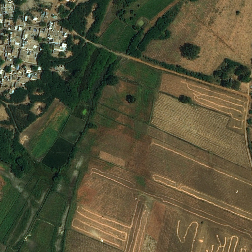

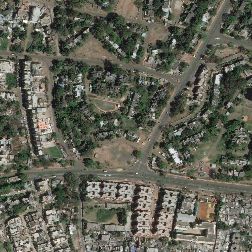

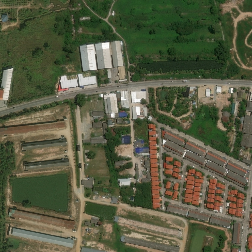

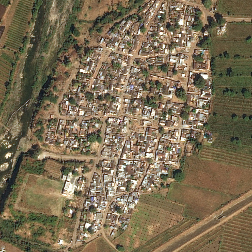

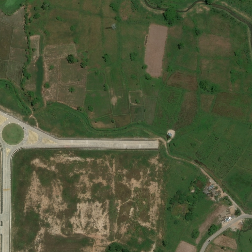

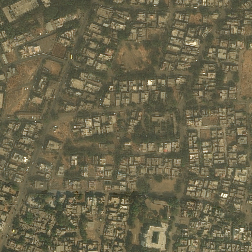

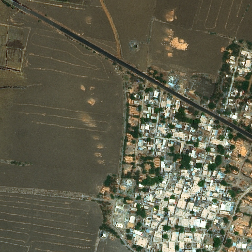

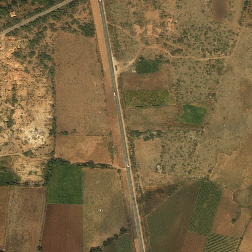

In [ ]:
for batch in train_ds.take(1):
    for img in batch:
        display(array_to_img(img))

### Preparación del conjunto de datos de test, este se usará luego del entrenamiento para ingresarle datos "nuevos" a la red y medir el desempeño de la misma

In [ ]:
test_path = os.path.join(path_img, "test")

test_img_paths = sorted([ os.path.join(test_path, fname)
                          for fname in os.listdir(test_path)
                          if fname.endswith(".jpg")  ])

<h1>
4. Operaciones sobre las imágenes
</h1>

<hr>

### Importancia de los espacios de color

- Se transforman las imágenes del espacio de color RGB al Espacio de color YUV (https://es.wikipedia.org/wiki/YUV). 

- Los datos de entrada a la red neuronal serán las imágenes de baja resolución, estas imágenes son recortadas, se recupera el canal 'y' (luminancia), y luego se redimensionan con el método 'area' de la librería tensorflow ( se puede lograr lo mismo con la función 'BICUBIC' de la librería PIL). 

- Solo se considera el canal de luminancia en el espacio de color YUV porque los seres humanos somos más sensibles a cambio de luminancia. 

- Para los datos de de referencia que son las imágenes de alta resolución, estas son las que ingreso a la red neuronal para que tome como patrón de aprendizaje, simplemente se recorta la imagen y se recupera el canal 'y'.

In [ ]:
# procesando las imágenes en baja resolucion
def process_input(input, input_size, upscale_factor):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return tf.image.resize(y, [input_size, input_size], method="area")

# procesando las imágenes en alta resolucion
def process_target(input):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return y

# aplicando procesamiento a entrenamiento y validación
train_ds = train_ds.map( lambda x: (process_input(x, input_size, upscale_factor), process_target(x)))
train_ds = train_ds.prefetch(buffer_size=32)

valid_ds = valid_ds.map( lambda x: (process_input(x, input_size, upscale_factor), process_target(x)))
valid_ds = valid_ds.prefetch(buffer_size=32)

Observar un batch de imágenes ingresadas a la red en baja y alta resolución

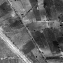

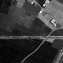

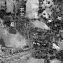

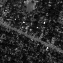

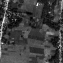

...

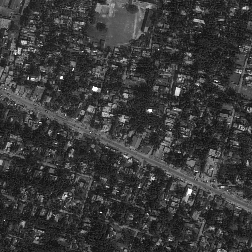

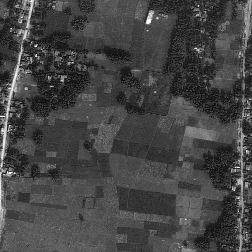

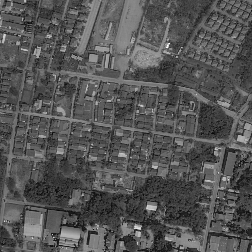

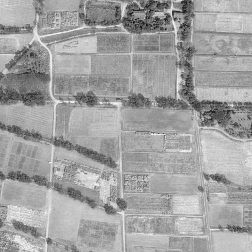

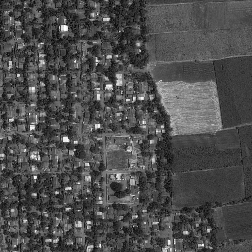

In [ ]:
for batch in train_ds.take(1):
  
    for img in batch[0]:
        display(array_to_img(img))
    for img in batch[1]:
        display(array_to_img(img))

<h1>
5. Construcción del Modelo de Red Neuronal Convolucional
</h1>

<hr>

### Modelo propio construido y calibrado 

Consiste en una arquitectura de red neuronal convolucional, esta arquitectura es de las más sencillas e interpretables y además muestra un gran desempeño en las tareas de reconocimiento de patrones en el área de visión por computador.

In [ ]:
# Factor de escalamiento de la imágen: 4
# numero de canales: 1  --- la luminancia  (Y)

def get_model(upscale_factor=upscale_factor, channels=1):

    conv_args = {   "activation": "relu",
                    "kernel_initializer": "Orthogonal",
                    "padding": "same"   }

    inputs = keras.Input(shape=(None, None, channels))
    x = layers.Conv2D(64, 5, **conv_args)(inputs)
    x = layers.Conv2D(64, 3, **conv_args)(x)
    x = layers.Conv2D(32, 3, **conv_args)(x)
    x = layers.Conv2D(channels * (upscale_factor ** 2), 3, **conv_args)(x)
    outputs = tf.nn.depth_to_space(x, upscale_factor)

    return keras.Model(inputs, outputs)


<h1>
6. Funciones a Utilizar en el entrenamiento y medición del desempeño de este modelo
</h1>

<hr>

- **plot_results:**  Mediante esta función se obtiene una imágen del dataset, en la cual se selecciona una subarea de la misma para mostrar durante el entrenamiento del modelo de red neuronal el proceso de mejoramiento en la resolución de la misma.


- ***get_lowres_image:*** Mediante esta función se le reduce la resolución a las imágenes


- ***upscale_image:*** Esta función se usa para convertir una imagen de baja resolución en una versión de alta resolución reconstruida por el modelo.  Usa el canal 'y' del espacio de color YUV como entrada para el modelo y se combina la salida con los otros canales para obtener una imagen RGB.

In [ ]:
def plot_results(img, prefix, title):
    # Función para graficar las imágenes, aplicando un recuadro con zoom para una pequeña área

    img_array = img_to_array(img)
    img_array = img_array.astype("float32") / 255.0

    # Crear una figura con los subplots
    fig, ax = plt.subplots()
    im = ax.imshow(img_array[::-1], origin="lower")

    plt.title(title)
    # zoom-factor: 2.0, Ubicación: Arriba - izquierda
    axins = zoomed_inset_axes(ax, 2, loc=2)
    axins.imshow(img_array[::-1], origin="lower")

    # Delimintando el cuadro del área a la que se le aplicará el zoom
    x1, x2, y1, y2 = 400, 500, 400, 500
    # aplicando los límites en X y Y
    axins.set_xlim(x1, x2)
    axins.set_ylim(y1, y2)
    plt.yticks(visible=False)
    plt.xticks(visible=False)

    # Construir la linea
    mark_inset(ax, axins, loc1=1, loc2=3, fc="none", ec="blue")
    plt.savefig(str(prefix) + "-" + title + ".png")
    plt.show()


def get_lowres_image(img, upscale_factor):
    # Reduce la resolución de las imágenes mediante un reescalamiento por un factor ingresado por el usuario

    return img.resize((img.size[0] // upscale_factor, img.size[1] // upscale_factor), PIL.Image.BICUBIC)


def upscale_image(model, img):
    # Convierte las imágenes al canal Y-Cb-Cr, luego realiza la predicción con el modelo y por ultimo reconstruye la imagen en RGB

    # conversión de espacio de color y 
    ycbcr = img.convert("YCbCr")
    y, cb, cr = ycbcr.split()
    y = img_to_array(y)
    y = y.astype("float32") / 255.0

    # Predicción con el modelo
    input = np.expand_dims(y, axis=0)
    out = model.predict(input)

    out_img_y = out[0]
    out_img_y *= 255.0

    # Restaurar la imagen en RGB
    out_img_y = out_img_y.clip(0, 255)
    out_img_y = out_img_y.reshape((np.shape(out_img_y)[0], np.shape(out_img_y)[1]))
    out_img_y = PIL.Image.fromarray(np.uint8(out_img_y), mode="L")
    out_img_cb = cb.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img_cr = cr.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img = PIL.Image.merge("YCbCr", (out_img_y, out_img_cb, out_img_cr)).convert("RGB")

    return out_img

<h1>
7. Definiendo los Callbacks para monitorear el entrenamiento
</h1>

<hr>

### Metricas de calidad de la imagen

Se definen las 3 funciones para medir la calidad de la imágen cómo: PSNR, MSE, y SSIM.  El **ínidice de similitud estructural (SSIM)**  es importada directamente desde scikit-image; las funciones de métricas **relacion pico-señal-ruido (PSNR)** y la clásica métrica en estadística **error cuadrático medio (MSE)** serán construídas por nosotros siguiendo las indicaciones de la teoría.

- La métrica [MSE](https://es.wikipedia.org/wiki/Error_cuadr%C3%A1tico_medio) mide la diferencia cuadrada promedio entre los valores de píxel reales e ideales. Esta métrica es fácil de calcular, pero podría no alinearse bien con la percepción humana de la calidad.

- La métrica [PSNR](https://es.abcdef.wiki/wiki/Peak_signal-to-noise_ratio) se deriva del error cuadrado medio, e indica la relación de la intensidad máxima de píxeles a la potencia de la distorsión. Al igual que el MSE, la métrica PSNR es fácil de calcular pero puede no alinearse bien con la calidad percibida.

- La métrica [SSIM](https://dees.abcdef.wiki/wiki/Strukturelle_%C3%84hnlichkeit) combina la estructura de imagen local, la luminancia y el contraste en una única puntuación de calidad local. En esta métrica, son patrones de intensidades de píxeles, especialmente entre píxeles vecinos, después de normalizar la luminancia y el contraste. 

**¿Por qué se usa el PSNR y no el SSIM ?**

El PSNR es más sensible al ruido gaussiano aditivo que el SSIM, mientras que lo contrario se observa para jpeg compresión. Ambas medidas tienen una sensibilidad ligeramente similar al desenfoque gaussiano y la compresión jpeg2000. En todos los casos,
han observado que el PSNR y el SSIM son más sensibles al ruido gaussiano aditivo que el desenfoque gaussiano, jpeg y compresión jpeg2000. Como conclusión final, parece que los valores de el PSNR se pueden predecir a partir del SSIM y viceversa. las métricas de calidad PSNR y SSIM difieren principalmente en su grado de sensibilidad a la degradación de la imagen




**Criterios de parada del entrenamiento:**

- **Tensorboard:** Se usa para estabalecer la conexión la API de google tensorboard
- **ModelCheckpoint:** Se usa para guardar los mejores pesos del entrenamiento.
- **EarlyStopping:** Se usa para parar el algoritmo cuando la metrica del error loss disminuya su decreciemiento.

In [ ]:
import math 

# función para calcular la relación pico señal ruido (peak signal to noise ratio - PSNR)
def psnr(target, ref):
         
    # recibe imágen RGB
    target_data = target.astype(float)
    ref_data = ref.astype(float)

    # diferencia entre el valor real y el valor de la predicción/distorsión
    diff = ref_data - target_data
    diff = diff.flatten('C')

    # el MSE entre 2 imágenes es la sumatoria de cuadrados para la resta entre la prediccion y el valor real
    mse = np.mean(diff ** 2.)

    return abs(20 * math.log10(1 / mse))

In [ ]:
# Definición del callback para medir el error
class ESPCNCallback(keras.callbacks.Callback):
    
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.test_img = get_lowres_image(load_img(test_img_paths[0]), upscale_factor)

    # guardar los valores de PSNR para cada epoch
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):

        print("Promedio de PSNR para el epoch: %.2f" % (np.mean(self.psnr)))
        
        # cada 2 epochs, mostrar gráficamente el proceso de calibración del modelo
        if epoch % 2 == 0:
            prediction = upscale_image(self.model, self.test_img)
            plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        # se construye el PSNR
        self.psnr.append(20 * math.log10(1 / logs["loss"]))

In [ ]:
# Mostrar el entrenamiento en tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

# criterio de callback para detener el entrenamiento
early_stopping_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=10)

# ubicación para guardar los mejores pesos
checkpoint_filepath = "/tmp/checkpoint"

# puntos para guardar del modelo ( guardar pesos )
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor="loss",
    mode="min",
    save_best_only=True )

model = get_model(upscale_factor=upscale_factor, channels=1)
model.summary()

callbacks = [ESPCNCallback(), early_stopping_callback, tensorboard_callback, model_checkpoint_callback]
loss_fn = keras.losses.MeanSquaredError()
optimizer = keras.optimizers.Adam(learning_rate=0.001)

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, None, None, 1)]   0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, None, None, 64)    1664      
_________________________________________________________________
conv2d_9 (Conv2D)            (None, None, None, 64)    36928     
_________________________________________________________________
conv2d_10 (Conv2D)           (None, None, None, 32)    18464     
_________________________________________________________________
conv2d_11 (Conv2D)           (None, None, None, 16)    4624      
_________________________________________________________________
tf.nn.depth_to_space_2 (TFOp (None, None, None, 1)     0         
Total params: 61,680
Trainable params: 61,680
Non-trainable params: 0
_______________________________________________________

<h1>
8. Entrenamiento del modelo
</h1>

<hr>


Epoch 1/10
744/744 [==============================] - 84s 112ms/step - loss: 0.0060 - val_loss: 0.0040
Promedio de PSNR para el epoch: 47.80


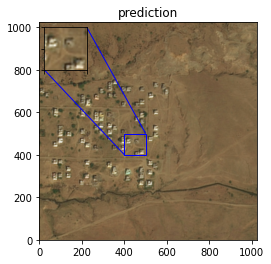

Epoch 2/10
744/744 [==============================] - 84s 113ms/step - loss: 0.0042 - val_loss: 0.0040
Promedio de PSNR para el epoch: 47.84
Epoch 3/10
744/744 [==============================] - 84s 112ms/step - loss: 0.0042 - val_loss: 0.0040
Promedio de PSNR para el epoch: 47.94


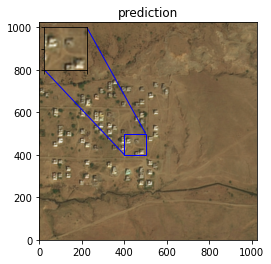

Epoch 4/10
744/744 [==============================] - 77s 102ms/step - loss: 0.0042 - val_loss: 0.0040
Promedio de PSNR para el epoch: 47.88
Epoch 5/10
744/744 [==============================] - 85s 113ms/step - loss: 0.0043 - val_loss: 0.0039
Promedio de PSNR para el epoch: 47.92


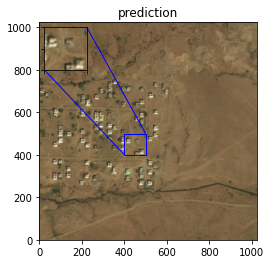

Epoch 6/10
744/744 [==============================] - 86s 115ms/step - loss: 0.0041 - val_loss: 0.0039
Promedio de PSNR para el epoch: 47.94
Epoch 7/10
744/744 [==============================] - 78s 104ms/step - loss: 0.0041 - val_loss: 0.0039
Promedio de PSNR para el epoch: 48.03


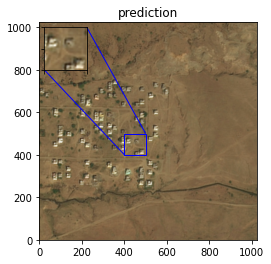

Epoch 8/10
744/744 [==============================] - 86s 115ms/step - loss: 0.0041 - val_loss: 0.0039
Promedio de PSNR para el epoch: 48.06
Epoch 9/10
744/744 [==============================] - 89s 119ms/step - loss: 0.0041 - val_loss: 0.0043
Promedio de PSNR para el epoch: 47.19


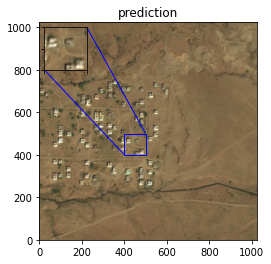

Epoch 10/10
744/744 [==============================] - 83s 111ms/step - loss: 0.0041 - val_loss: 0.0039
Promedio de PSNR para el epoch: 48.05


In [ ]:
epochs = 10

model.compile(optimizer=optimizer, loss=loss_fn)

history = model.fit(train_ds, epochs=epochs, callbacks=callbacks, validation_data=valid_ds, verbose=1)

# Cargar los mejores pesos en el modelo
model.load_weights(checkpoint_filepath)

<h1>
9.     Gráficas en Tensorboard
</h1>

<hr>

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/fit

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

<Figure size 432x288 with 0 Axes>

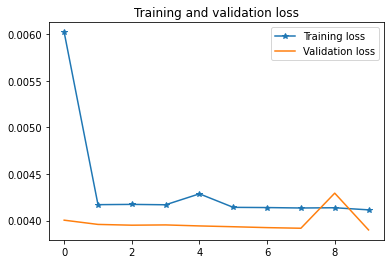

<Figure size 432x288 with 0 Axes>

In [ ]:
loss     = history.history[    'loss' ]
val_loss = history.history['val_loss' ]

epochs   = range(len(loss)) 

#------------------------------------------------#
# Graficar training and validation loss          #
#------------------------------------------------#
plt.plot  ( epochs,     loss , '*-', label='Training loss')
plt.plot  ( epochs, val_loss, label='Validation loss')
plt.title ('Training and validation loss'   )

plt.legend(loc='upper right')
plt.figure()

<h1>
10. Predicciones del modelo
</h1>

<hr>

### Se realizan predicciones para un grupo de imágenes y además se muestra gráficamente, en una ventana la mejora de la resolución para una fracción de la imágen. Además se aplican métricas de medida del error

PSNR para imágen en super resolución: 33.1103


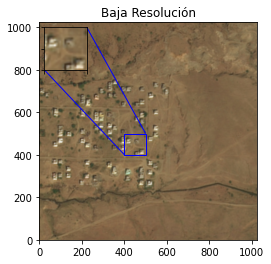

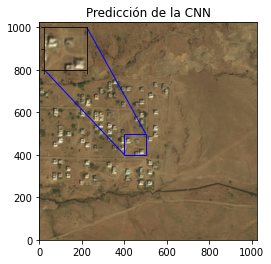

PSNR para imágen en super resolución: 37.6835


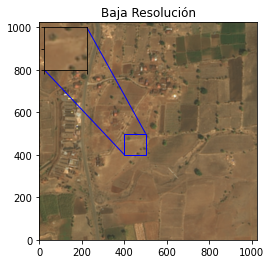

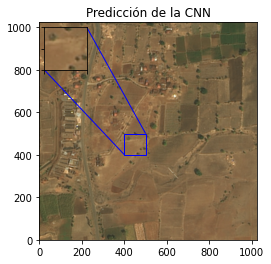

PSNR para imágen en super resolución: 36.1491


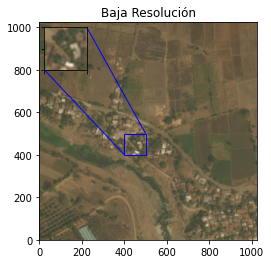

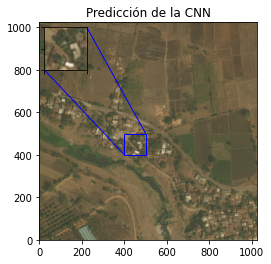

PSNR para imágen en super resolución: 45.7574


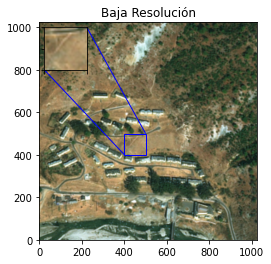

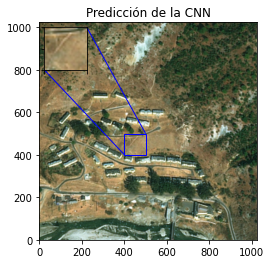

PSNR para imágen en super resolución: 33.3296


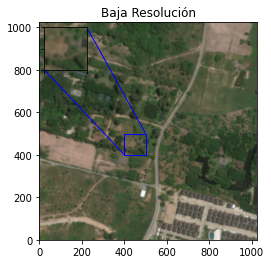

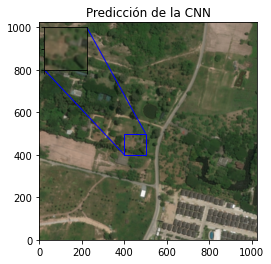

PSNR para imágen en super resolución: 30.7803


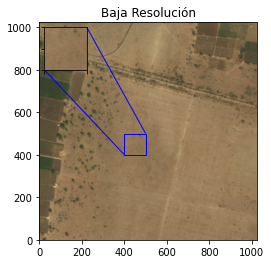

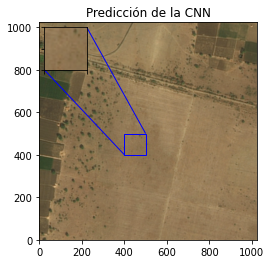

PSNR para imágen en super resolución: 53.4313


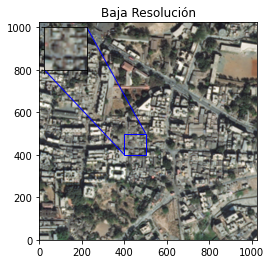

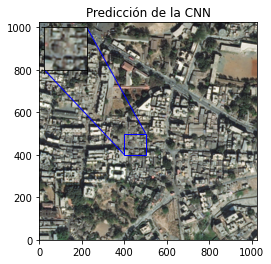

PSNR para imágen en super resolución: 28.7927


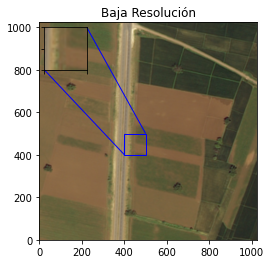

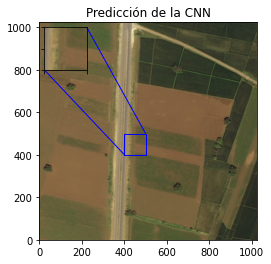

PSNR para imágen en super resolución: 39.1327


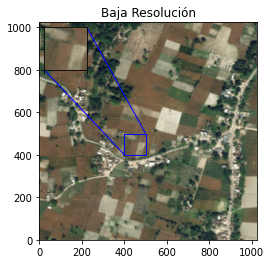

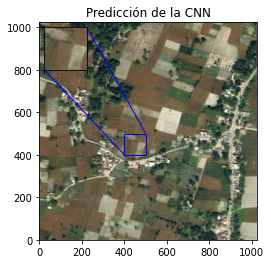

PSNR para imágen en super resolución: 34.1860


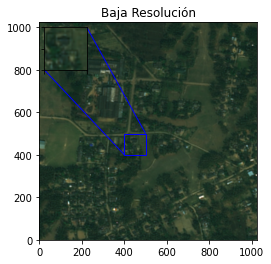

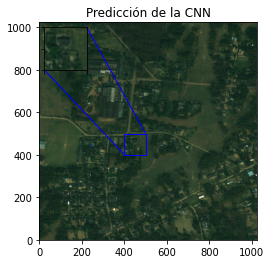

PSNR para imágen en super resolución: 30.7787


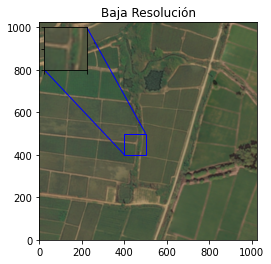

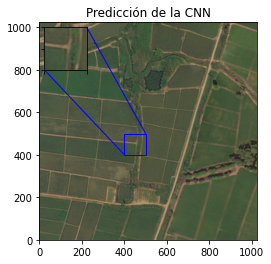

PSNR para imágen en super resolución: 44.0408


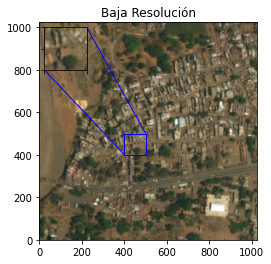

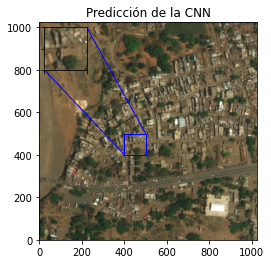

PSNR para imágen en super resolución: 33.1490


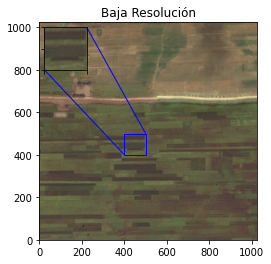

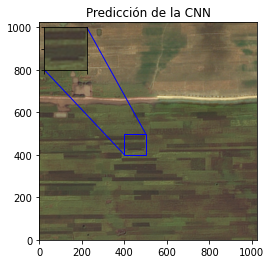

PSNR para imágen en super resolución: 37.1734


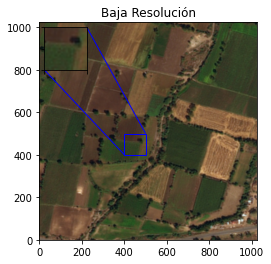

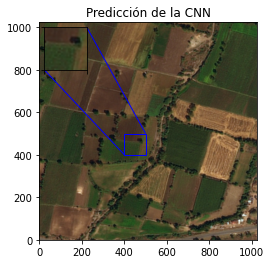

PSNR para imágen en super resolución: 34.3347


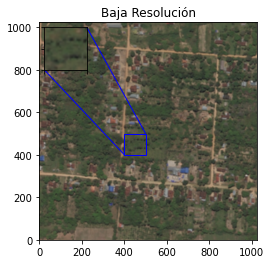

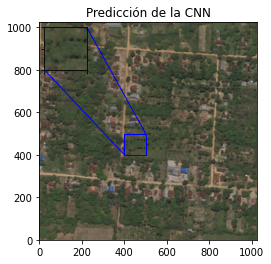

PSNR para imágen en super resolución: 42.2597


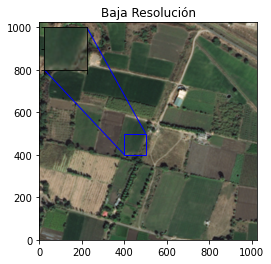

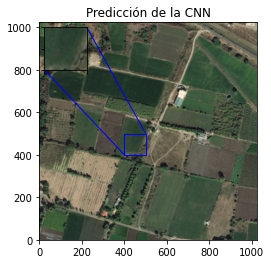

PSNR para imágen en super resolución: 38.9864


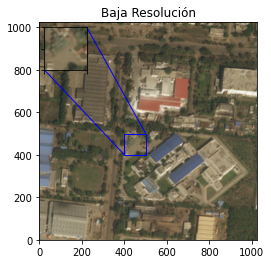

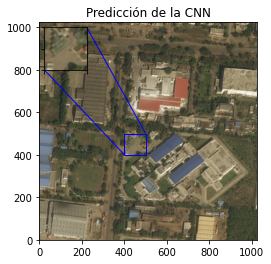

PSNR para imágen en super resolución: 35.0636


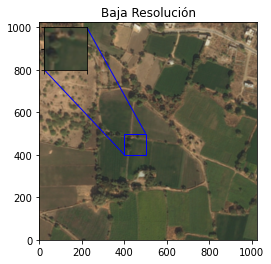

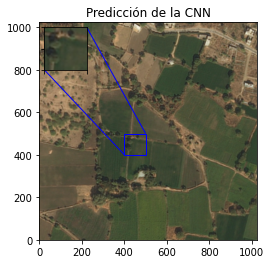

PSNR para imágen en super resolución: 37.8717


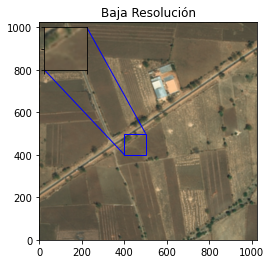

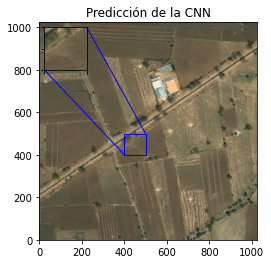

PSNR para imágen en super resolución: 31.4363


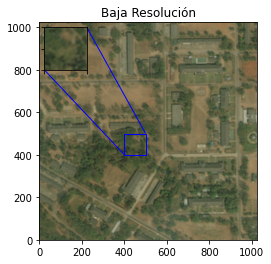

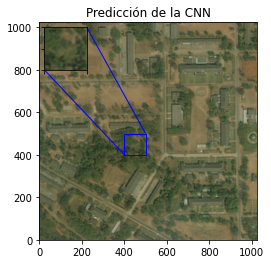

PSNR para imágen en super resolución: 34.4949


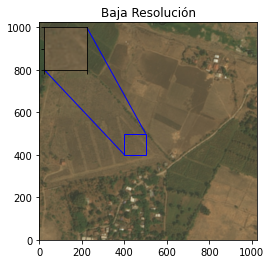

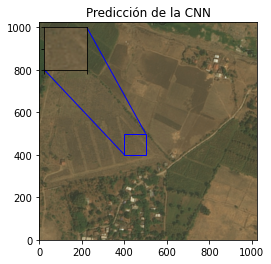

PSNR para imágen en super resolución: 33.9777


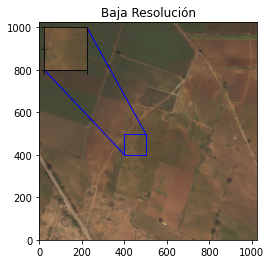

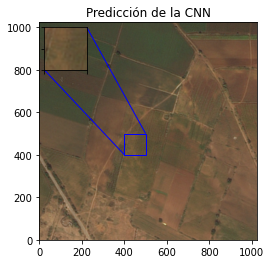

PSNR para imágen en super resolución: 32.3277


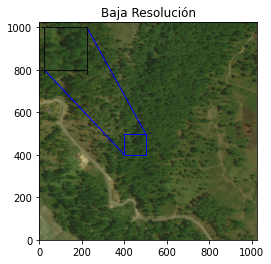

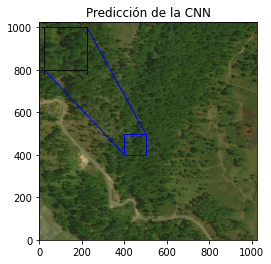

PSNR para imágen en super resolución: 31.0617


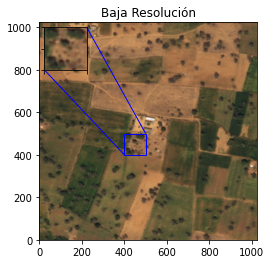

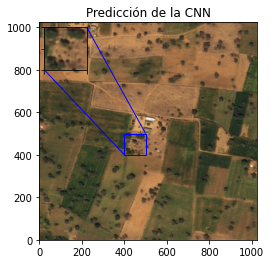

PSNR para imágen en super resolución: 38.6194


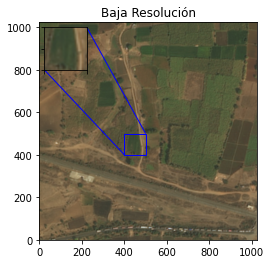

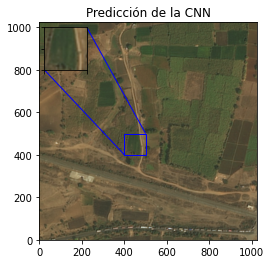

PSNR para imágen en super resolución: 42.6064


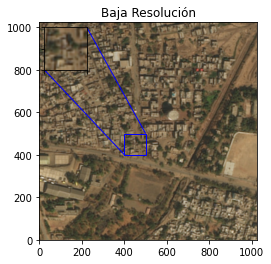

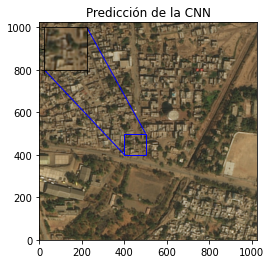

PSNR para imágen en super resolución: 38.5556


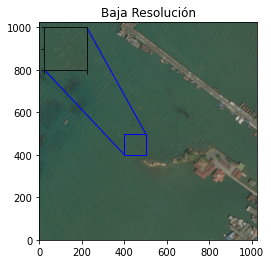

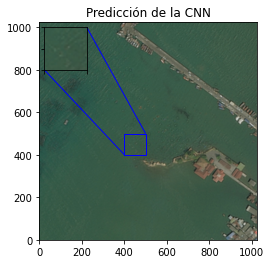

PSNR para imágen en super resolución: 32.5417


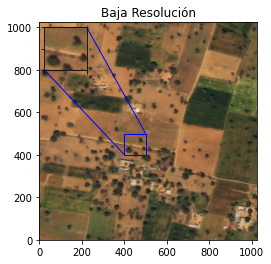

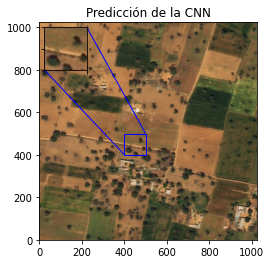

PSNR para imágen en super resolución: 41.7699


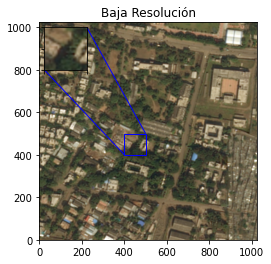

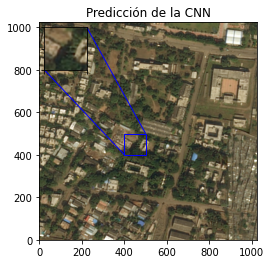

PSNR para imágen en super resolución: 32.0372


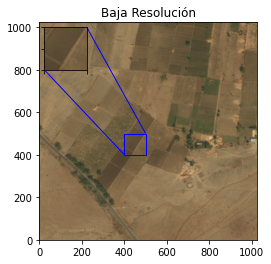

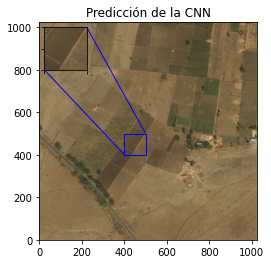

PSNR para imágen en super resolución: 48.3223


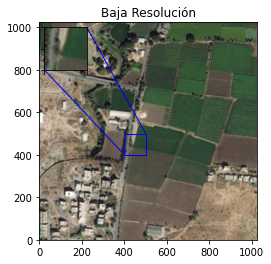

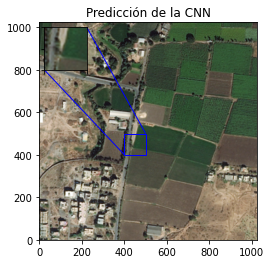

PSNR para imágen en super resolución: 37.6273


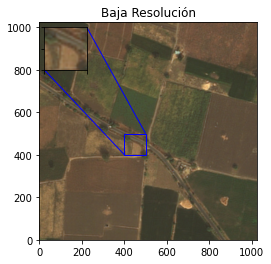

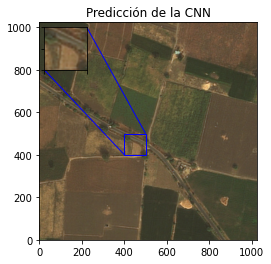

PSNR para imágen en super resolución: 38.9230


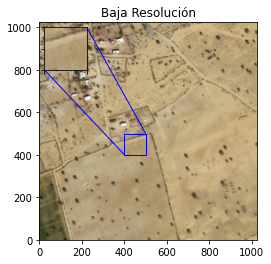

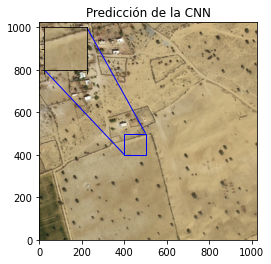

PSNR para imágen en super resolución: 33.9596


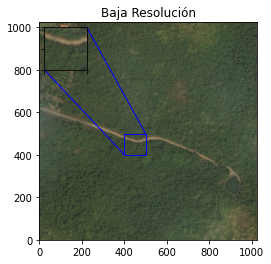

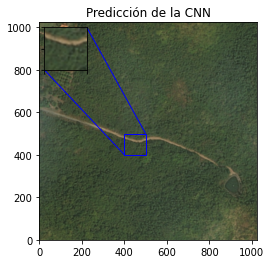

PSNR para imágen en super resolución: 38.5818


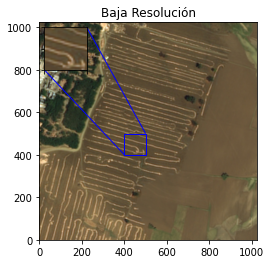

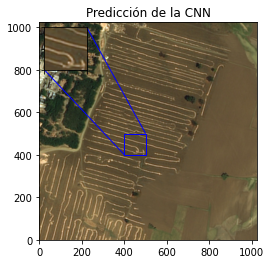


Promedio PSNR para imágenes en super resolución: 46.1733


In [ ]:
total_bicubic_psnr = []
total_test_psnr = []

for index, test_img_path in enumerate(test_img_paths[0:len(test_img_paths)-1]):

    # lectura y preprocesamiento de dimensiones de la imagen de test
    img = load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))

    # Llamado a la función que realiza la prediccion del modelo
    prediction = upscale_image(model, lowres_input)

    # reedimensionado de la imagen en baja resolución para mostrarla
    lowres_img = lowres_input.resize((w, h))

    # Convertir imágen en un array
    lowres_img_arr = img_to_array(lowres_img)
    highres_img_arr = img_to_array(highres_img)
    predict_img_arr = img_to_array(prediction)

    # cálculo del psnr para cada imágen
    test_psnr = psnr(predict_img_arr, highres_img_arr)

    # cálculo del psnr promedio
    total_test_psnr.append(test_psnr)

    print("PSNR para imágen en super resolución: %.4f" % test_psnr)

    # Graficar las imágenes
    plot_results(lowres_img, index, "Baja Resolución")
    plot_results(prediction, index, "Predicción de la CNN")
    #plot_results(highres_img, index, "Alta Resolución")
    

print("\nPromedio PSNR para imágenes en super resolución: %.4f" % (sum(total_test_psnr) / (len(total_test_psnr))))